# The implementation of U-Net fully convolutional neural network
Full basic implementation according to the white-paper.  
"U-Net: Convolutional Networks for Biomedical Image Segmentation"  
https://arxiv.org/pdf/1505.04597.pdf  

In [78]:
import datetime
import pathlib
import sys
import random

import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display

from PIL import Image, ImageDraw

from sklearn.model_selection import train_test_split


%load_ext autoreload
%autoreload 2

Image.MAX_IMAGE_PIXELS = None

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
SEED=241
random.seed(SEED)
np.random.seed(SEED)

In [3]:
plt.rcParams["figure.figsize"] = [26,19]

# 1 Create dataset

In [4]:
def load_map_and_mask(map_file, mask_file, workspace_dir):
    map_img = Image.open(str(map_file))
    
    polygons = []

    with open(str(mask_file)) as f:
        for line in f:
            line = line.strip()
            points = line.split(' ')
            polygon = [(int(xy[0]), int(xy[1])) for xy in [point.split(',') for point in points]]
            polygons.append(polygon)
       
    mask_img = Image.new('1', map_img.size, 0)

    for p in polygons:
        ImageDraw.Draw(mask_img).polygon(p, fill=1)
    
    mask_img.convert('RGB').save(str(workspace_dir/(mask_file.stem + '.jpg')), format='JPEG', quality=100)
    
    return map_img, mask_img  

def plot_masks(map_imgs, mask_imgs):
    rows = len(map_imgs)
    cols = 2
    
    for i, m in enumerate(map_imgs):
        plt.subplot(rows,cols, cols*i +1)
        plt.imshow(m)

        plt.subplot(rows,cols,cols*i +2)
        plt.imshow(mask_imgs[i])
        
    plt.show()

def map_stats(map_img, mask_img):
    m = np.array(mask_img).astype(np.byte)
    n = np.sum(m == 0)
    k = np.sum(m == 1)
    
    print(map_img.size)
    print('zeros ratio', 0 if n == 0 else round(n/(n+k), 3))
    print('ones ratio', 0 if k == 0 else round(k/(n+k), 3))

In [6]:
dataset_dir = pathlib.Path().cwd() / 'external_data' / 'data' / 'train'
src_images = list(dataset_dir.glob('**/*.tif'))
src_images = [img_p for img_p in src_images if '.mask.' not in img_p.name]

print('src_images', len(src_images))

src_images 13


In [7]:
timestamp = datetime.datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
workspace_dir = pathlib.Path().cwd() / ('workspace_' + str(timestamp))
workspace_dir.mkdir(parents=True)

### 1.1 Read source Map images

In [8]:
src_images_and_masks = []

for img_p in src_images:
    map_img, mask = load_map_and_mask(img_p, img_p.parent/(img_p.stem + '.markup.txt'), workspace_dir) 
    src_images_and_masks.append({
        'map': map_img,
        'mask': mask
    })
    
    print('Stats for', img_p)
    map_stats(map_img, mask)
    print()

Stats for /home/sergey_sintsov/dubai/external_data/data/train/1/1.tif
(14475, 9834)
zeros ratio 0.866
ones ratio 0.134

Stats for /home/sergey_sintsov/dubai/external_data/data/train/10/10.tif
(15544, 9834)
zeros ratio 0.342
ones ratio 0.658

Stats for /home/sergey_sintsov/dubai/external_data/data/train/11/11.tif
(15544, 9834)
zeros ratio 0.428
ones ratio 0.572

Stats for /home/sergey_sintsov/dubai/external_data/data/train/2/2.tif
(14475, 9834)
zeros ratio 0.989
ones ratio 0.011

Stats for /home/sergey_sintsov/dubai/external_data/data/train/3/3.tif
(10088, 7022)
zeros ratio 0.309
ones ratio 0.691

Stats for /home/sergey_sintsov/dubai/external_data/data/train/4/4.tif
(15403, 9834)
zeros ratio 0.447
ones ratio 0.553

Stats for /home/sergey_sintsov/dubai/external_data/data/train/5/5.tif
(13988, 9834)
zeros ratio 0.612
ones ratio 0.388

Stats for /home/sergey_sintsov/dubai/external_data/data/train/6/6.tif
(15544, 9834)
zeros ratio 0.571
ones ratio 0.429

Stats for /home/sergey_sintsov/dubai

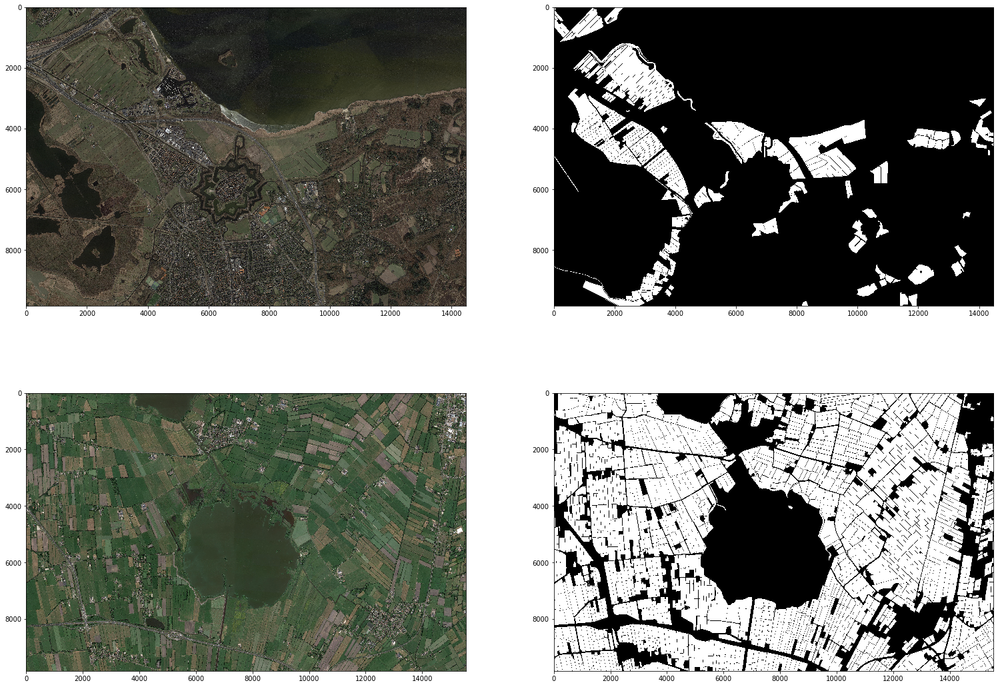

In [9]:
plot_masks(
    [src['map'] for src in src_images_and_masks][:2], 
    [src['mask'] for src in src_images_and_masks][:2]
)

### 1.2 Create dataset images by cropping source Maps

In [72]:
def cut_map_into_tiles(map_img, 
                       mask_img, 
                       tile_size=100, 
                       tile_resize=100, 
                       tiles_count=100,
                       tile_prefix='',
                       save_tiles=True,
                       save_dir=None):
    X = []
    Y = []

    width, height = map_img.size
    
    top_left_coordinates = zip(
        np.random.randint(0, width - tile_size, tiles_count), 
        np.random.randint(0, height - tile_size, tiles_count)
    )

    map_img_in_rgb = map_img.convert('RGB')
    
    for i, (x,y) in enumerate(top_left_coordinates):
        tile = map_img_in_rgb.crop( (x, y, x+tile_size, y+tile_size) )
        tile_mask = mask_img.crop( (x, y, x+tile_size, y+tile_size) )

        tile = tile.resize((tile_resize, tile_resize))
        tile_mask = tile_mask.resize((tile_resize, tile_resize))
        
        mp = np.array(tile)
               
        mask = np.array(tile_mask).astype(np.byte)
       
        X.append(mp)
        Y.append(mask)
        
        if save_tiles:
            np.save(str(save_dir/(tile_prefix + 'map_' + str(i) + '.np')), mp)
            np.save(str(save_dir/(tile_prefix + 'mask_' + str(i) + '.np')), mask)
        
    return X, Y

def tiles_stats(Y):
    zeros_count = 0
    ones_count = 0
    for y in Y:
        zeros_count += np.sum((y==0))
        ones_count += np.sum((y==1))

    print('zeros', zeros_count)
    print('ones', ones_count)
    
    if zeros_count > 0:
        print('zeros ratio', zeros_count/(ones_count + zeros_count))
    if ones_count > 0:
        print('ones ratio', ones_count/(ones_count + zeros_count))
    print()

In [12]:
TILES_SIZE = 1024
TILES_COUNT = 1000
UNET_INPUT_SIZE = 256

X = []
Y = []

tiles_folder = workspace_dir / 'train_tiles'
tiles_folder.mkdir(parents=True, exist_ok=True)
    
for i, src in enumerate(src_images_and_masks):
    x, y = cut_map_into_tiles(
        src['map'], 
        src['mask'], 
        tile_size=TILES_SIZE,
        tile_resize=UNET_INPUT_SIZE,
        tiles_count=TILES_COUNT,
        tile_prefix=str(i),
        save_dir=tiles_folder
    )
    
    X += x
    Y += y
    print('done', i)
    
print('X', len(X))
print('Y', len(Y))
tiles_stats(Y)

done 0
done 1
done 2
done 3
done 4
done 5
done 6
done 7
done 8
done 9
done 10
done 11
done 12
X 13000
Y 13000
zeros 478009412
ones 373958588
zeros ratio 0.5610649836613582
ones ratio 0.43893501633864185



In [13]:
X = np.array(X)
Y = np.array(Y)[...,np.newaxis]

print(X.shape, Y.shape)

np.save(str(workspace_dir/'X.np'), X)
np.save(str(workspace_dir/'Y.np'), Y)

(13000, 256, 256, 3) (13000, 256, 256, 1)


### 1.3 View cropped images

In [14]:
def binary_mask_to_img(data):
    size = data.shape[::-1]
    databytes = np.packbits(data, axis=1)
    
    return Image.frombytes(mode='1', size=size, data=databytes)

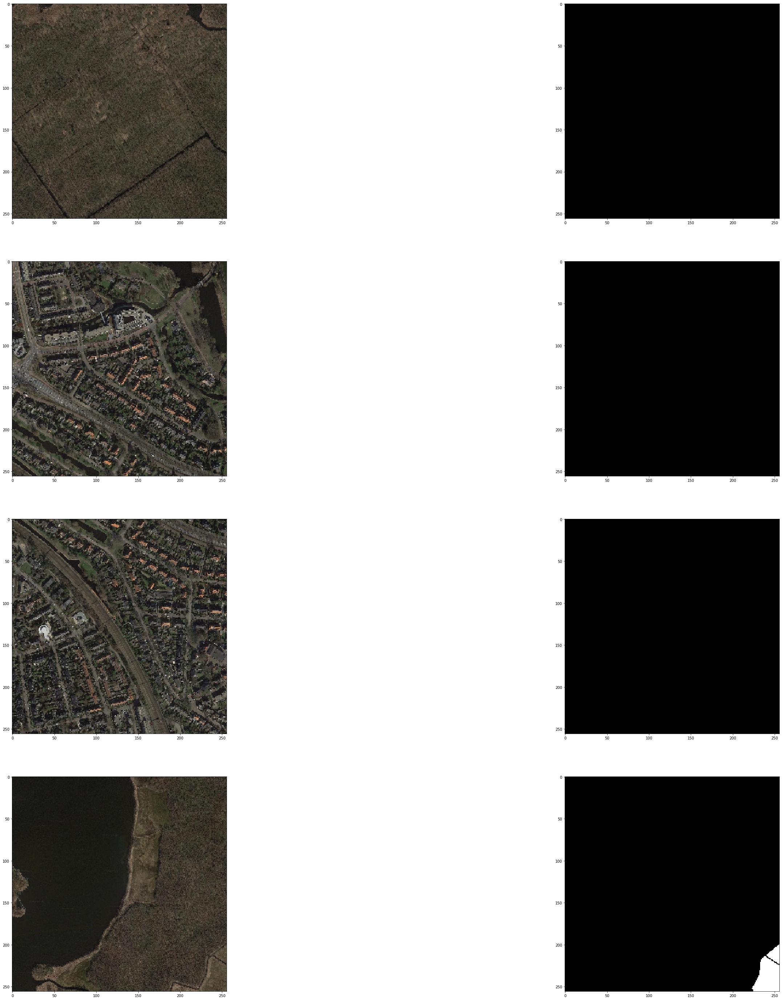

In [15]:
# Show train data
show_count = 4
train_maps = [Image.fromarray(x.astype('uint8'), 'RGB') for x in X[:show_count]]
train_masks = [binary_mask_to_img(y[:,:,-1]) for y in Y[:show_count]]

plt.rcParams["figure.figsize"] = [50,50]
plot_masks(train_maps, train_masks)

# 2. Create and train U-Net model

In [16]:
import tensorflow as tf
from tensorflow.python.client import device_lib
from tensorflow.keras import backend as K
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import (ModelCheckpoint, LearningRateScheduler, ModelCheckpoint, EarlyStopping, 
                                        ReduceLROnPlateau, TensorBoard, TerminateOnNaN, Callback)
from tensorflow.keras.models import load_model
from tensorflow.keras.models import model_from_json
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [17]:
tf.__version__

'1.11.0'

In [18]:
def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

['/device:GPU:0']

### 2.1 Create U-net

In [38]:
def create_unet(input_sz=512):
    image_input = Input((input_sz, input_sz, 3))

# contracting path (down-sampling)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(image_input)
    conv2 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool1)
    conv4 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv3)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool2)
    conv6 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv5)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv6)

    conv7 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool3)
    conv8 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv7)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv8)

    conv9 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool4)
    conv10 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    
# expansive path (up-sampling)
    up_conv11 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(
        UpSampling2D(size = (2,2))(conv10)
    )
    cancat1 = concatenate([conv8, up_conv11], axis = 3)
    conv12 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(cancat1)
    conv13 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv12)
    
    up_conv14 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(
        UpSampling2D(size = (2,2))(conv13)
    )
    cancat2 = concatenate([conv6, up_conv14], axis = 3)
    conv15 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(cancat2)
    conv16 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv15)
    
    up_conv17 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(
        UpSampling2D(size = (2,2))(conv16)
    )
    cancat3 = concatenate([conv4, up_conv17], axis = 3)
    conv18 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(cancat3)
    conv19 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv18)

    up_conv20 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(
        UpSampling2D(size = (2,2))(conv19)
    )
    cancat4 = concatenate([conv2, up_conv20], axis = 3)
    conv21 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(cancat4)
    conv22 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv21)
    conv22 = SpatialDropout2D(0.2)(conv22)
    
    conv23 = Conv2D(1, 1, 1, activation = 'sigmoid')(conv22)

    return Model(inputs = [image_input], outputs = conv23)

In [64]:
unet = create_unet(input_sz=UNET_INPUT_SIZE)
unet.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
conv2d_48 (Conv2D)              (None, 256, 256, 32) 896         input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_49 (Conv2D)              (None, 256, 256, 32) 9248        conv2d_48[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_8 (MaxPooling2D)  (None, 128, 128, 32) 0           conv2d_49[0][0]                  
__________________________________________________________________________________________________
conv2d_50 

### 2.2 Train U-net

In [40]:
def preprocess_inputs(X):
    return (2.0 / 255.0) * X - 1.0

In [41]:
X_preprocessed = preprocess_inputs(X)

MemoryError: 

In [65]:
from keras.losses import binary_crossentropy

SMOOTH = 1

def jaccard_score(gt, pr, smooth=SMOOTH, threshold=None):
    """ 
        Jaccard index https://en.wikipedia.org/wiki/Jaccard_index
    Args:
        gt: ground truth 4D keras tensor (B, H, W, C)
        pr: prediction 4D keras tensor (B, H, W, C)
        smooth: value to avoid division by zero
        threshold: value to round predictions (use ``>`` comparison), 
                   if ``None`` prediction prediction will not be round
    Returns:
        IoU/Jaccard score in range [0, 1]
    """
    axes = [1, 2]
        
    if threshold is not None:
        pr = K.greater(pr, threshold)
        pr = K.cast(pr, K.floatx())

    intersection = K.sum(gt * pr, axis=axes)
    union = K.sum(gt + pr, axis=axes) - intersection
    iou = (intersection + smooth) / (union + smooth)

    iou = K.mean(iou, axis=0)

    return iou

In [66]:
def create_default_callbacks(workspace_dir, batch_sz=1):
    timestamp = datetime.datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
    checkpoint_folder = workspace_dir / 'checkpoints' / str(timestamp)
    checkpoint_folder.mkdir(parents=True)
    tensorboard_folder = workspace_dir / 'tensorboard_logs' / str(timestamp)
    
    checkpoint = ModelCheckpoint(
        str(checkpoint_folder / 'model-{loss:.2f}.h5'),
        monitor='loss',
        verbose=1,
        save_best_only=True,
        save_weights_only=True,
        mode='auto',
        period=1
    )
    
    stop = EarlyStopping(monitor='loss', patience=200, mode='min', verbose=1)
    reduce_lr = ReduceLROnPlateau(monitor='loss', factor=0.5, patience=5, min_lr=1e-9, verbose=1, mode='min')
    
    tensorboard = TensorBoard(log_dir=str(tensorboard_folder),
                              histogram_freq=0,
                              batch_size=batch_sz,
                              write_graph=False, 
                              write_grads=False, 
                              write_images=False,
                              embeddings_freq=0, 
                              embeddings_layer_names=None, 
                              embeddings_metadata=None, 
                              embeddings_data=None)
    
    return [reduce_lr, TerminateOnNaN(), checkpoint, tensorboard], checkpoint_folder


def train(model, X_train, Y_train, workspace_dir, epochs=1, batch_sz=1):
    #sgd = SGD(lr=0.01, decay=1e-6, momentum=0.99, nesterov=True)
    
    unet.compile(
        #optimizer=sgd, 
        optimizer='Adam',
        loss=binary_crossentropy,
        metrics=[jaccard_score, 'binary_accuracy']
    )
        
    callbacks, checkpoint_dir = create_default_callbacks(workspace_dir, batch_sz=batch_sz)
    
    model_json = model.to_json()
    with open(str(checkpoint_dir/'graph.json'), 'w') as json_file:
        json_file.write(model_json)
       
    return model.fit(
        X_train, Y_train,
        batch_size=batch_sz,
        epochs=epochs,
        callbacks=callbacks,
        shuffle=True
    )

In [68]:
train(unet, X_preprocessed, Y, workspace_dir, epochs=700, batch_sz=16)

Epoch 1/700
12992/13000 [============================>.] - ETA: 0s - loss: 7.1284 - jaccard_score: 0.3156 - binary_accuracy: 0.8193
Epoch 00001: loss improved from inf to 7.12597, saving model to /home/sergey_sintsov/dubai/workspace_2019-06-26-07-35-58/checkpoints/2019-06-26-08-44-13/model-7.13.h5
13000/13000 [==============================] - 187s 14ms/step - loss: 7.1260 - jaccard_score: 0.3157 - binary_accuracy: 0.8193
Epoch 2/700
12992/13000 [============================>.] - ETA: 0s - loss: 4.8729 - jaccard_score: 0.4059 - binary_accuracy: 0.9033
Epoch 00002: loss improved from 7.12597 to 4.87104, saving model to /home/sergey_sintsov/dubai/workspace_2019-06-26-07-35-58/checkpoints/2019-06-26-08-44-13/model-4.87.h5
13000/13000 [==============================] - 180s 14ms/step - loss: 4.8710 - jaccard_score: 0.4059 - binary_accuracy: 0.9033
Epoch 3/700
12992/13000 [============================>.] - ETA: 0s - loss: 3.8339 - jaccard_score: 0.4628 - binary_accuracy: 0.9235
Epoch 00003:

Epoch 44/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.5102 - jaccard_score: 0.7551 - binary_accuracy: 0.9873
Epoch 00044: loss did not improve from 0.47203
13000/13000 [==============================] - 180s 14ms/step - loss: 0.5100 - jaccard_score: 0.7550 - binary_accuracy: 0.9873
Epoch 45/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.5686 - jaccard_score: 0.7513 - binary_accuracy: 0.9861
Epoch 00045: loss did not improve from 0.47203
13000/13000 [==============================] - 181s 14ms/step - loss: 0.5685 - jaccard_score: 0.7513 - binary_accuracy: 0.9861
Epoch 46/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.6043 - jaccard_score: 0.7329 - binary_accuracy: 0.9851
Epoch 00046: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.

Epoch 00046: loss did not improve from 0.47203
13000/13000 [==============================] - 181s 14ms/step - loss: 0.6042 - jaccard_score: 0.7330 - binary_accuracy: 0.985

Epoch 66/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.3243 - jaccard_score: 0.8285 - binary_accuracy: 0.9916
Epoch 00066: loss improved from 0.33271 to 0.32412, saving model to /home/sergey_sintsov/dubai/workspace_2019-06-26-07-35-58/checkpoints/2019-06-26-08-44-13/model-0.32.h5
13000/13000 [==============================] - 180s 14ms/step - loss: 0.3241 - jaccard_score: 0.8284 - binary_accuracy: 0.9916
Epoch 67/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.3173 - jaccard_score: 0.8297 - binary_accuracy: 0.9918
Epoch 00067: loss improved from 0.32412 to 0.31728, saving model to /home/sergey_sintsov/dubai/workspace_2019-06-26-07-35-58/checkpoints/2019-06-26-08-44-13/model-0.32.h5
13000/13000 [==============================] - 180s 14ms/step - loss: 0.3173 - jaccard_score: 0.8298 - binary_accuracy: 0.9918
Epoch 68/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.3183 - jaccard_score: 0.8288 - binary_accuracy: 0.9918
Epoch

Epoch 89/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.2625 - jaccard_score: 0.8604 - binary_accuracy: 0.9932
Epoch 00089: loss improved from 0.26478 to 0.26243, saving model to /home/sergey_sintsov/dubai/workspace_2019-06-26-07-35-58/checkpoints/2019-06-26-08-44-13/model-0.26.h5
13000/13000 [==============================] - 180s 14ms/step - loss: 0.2624 - jaccard_score: 0.8604 - binary_accuracy: 0.9932
Epoch 90/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.2615 - jaccard_score: 0.8606 - binary_accuracy: 0.9932
Epoch 00090: loss improved from 0.26243 to 0.26138, saving model to /home/sergey_sintsov/dubai/workspace_2019-06-26-07-35-58/checkpoints/2019-06-26-08-44-13/model-0.26.h5
13000/13000 [==============================] - 180s 14ms/step - loss: 0.2614 - jaccard_score: 0.8607 - binary_accuracy: 0.9932
Epoch 91/700
12992/13000 [============================>.] - ETA: 0s - loss: 0.2549 - jaccard_score: 0.8653 - binary_accuracy: 0.9934
Epoch

KeyboardInterrupt: 

# 3 Check the model

### 3.1 Load trained model

In [69]:
import json

final_model_path = workspace_dir / 'checkpoints' / '2019-06-26-08-44-13' / 'model-0.23.h5'

with open(str(final_model_path.parent / 'graph.json'), 'r') as json_file:
    fitted_model = model_from_json(json_file.read())
    
fitted_model.load_weights(str(final_model_path), by_name=True)

In [71]:
fitted_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
conv2d_48 (Conv2D)              (None, 256, 256, 32) 896         input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_49 (Conv2D)              (None, 256, 256, 32) 9248        conv2d_48[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_8 (MaxPooling2D)  (None, 128, 128, 32) 0           conv2d_49[0][0]                  
__________________________________________________________________________________________________
conv2d_50 

### 3.2 Use test images

In [73]:
X_test = []
Y_test = []

for i, src in enumerate(src_images_and_masks):
    x, y = cut_map_into_tiles(
        src['map'], 
        src['mask'], 
        tile_size=TILES_SIZE,
        tile_resize=UNET_INPUT_SIZE,
        tiles_count=10,
        tile_prefix=str(i),
        save_tiles=False
    )
    
    X_test += x
    Y_test += y
    print('done', i)

done 0
done 1
done 2
done 3
done 4
done 5
done 6
done 7
done 8
done 9
done 10
done 11
done 12


### 3.3 Run inference

In [84]:
def convert_grayscale_data_to_red_rgba(mask, alpha_value=50):
    data = (mask * 255).astype('uint8')
    alpha = (mask * alpha_value).astype('uint8')

    data = data.reshape((data.shape[0], data.shape[1], 1))
    npad = ((0, 0), (0, 0), (0, 2))
    rgba_array = np.pad(data, pad_width=npad, mode='constant', constant_values=0)

    rgba_array = np.insert(
        rgba_array,
        3,
        alpha,
        axis=2
    )
    return Image.fromarray(rgba_array, 'RGBA')

def apply_predicted_mask(orig_image, predicted_2d_values):
    predicted_img = convert_grayscale_data_to_red_rgba(predicted_2d_values)

    orig_image = Image.fromarray(orig_image.astype('uint8'), 'RGB')
    orig_image = orig_image.convert('RGBA')
    orig_image.paste(predicted_img, (0, 0), predicted_img)

    return orig_image.convert('RGB')

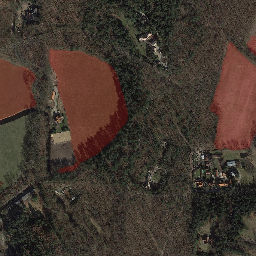

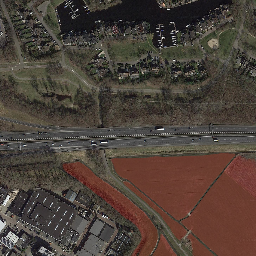

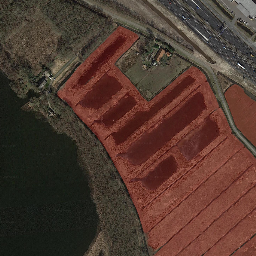

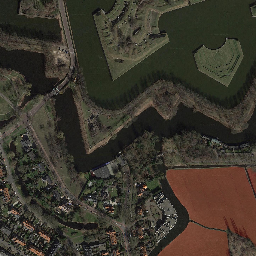

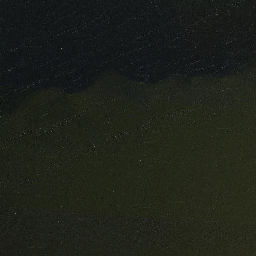

...

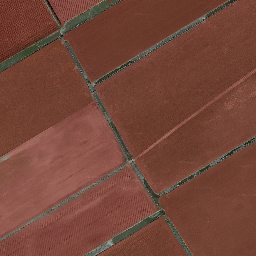

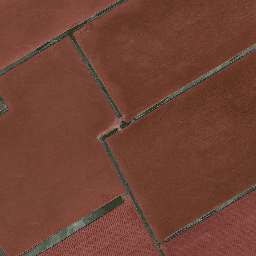

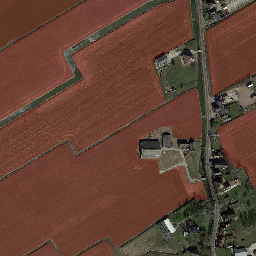

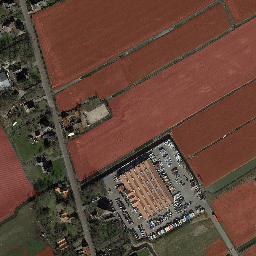

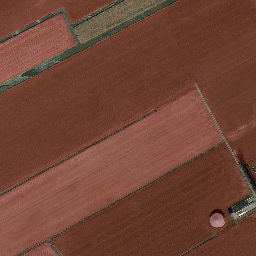

In [85]:
for x,y in zip(X_test, Y_test):
    x_np = preprocess_inputs(np.array(x))
    predicted = fitted_model.predict(x_np[np.newaxis,:,:,:])
    predicted_2d = predicted.reshape((predicted.shape[1], predicted.shape[2]))
    
    display(apply_predicted_mask(x, predicted_2d))